In [6]:
# Importing required library
import pandas as pd
import numpy as np
from sklearn.model_selection import KFold,GridSearchCV,train_test_split
from sklearn.cross_decomposition import PLSRegression
from sklearn.linear_model import LarsCV,LassoCV,LinearRegression,LogisticRegression,GammaRegressor
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score,auc,f1_score,confusion_matrix,classification_report
from statsmodels.stats import outliers_influence,regularized_covariance
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
import warnings
warnings.filterwarnings('ignore')


In [7]:
# Uploading Dataset into Jupiter Note Book
df=pd.read_csv(r'D:\Datatrained\Practice Project Data Trained\Red Wine Quality\winequality-red.csv')
df.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5
1,7.8,0.88,0.00,2.6,0.098,25.0,67.0,0.9968,3.20,0.68,9.8,5
2,7.8,0.76,0.04,2.3,0.092,15.0,54.0,0.9970,3.26,0.65,9.8,5
3,11.2,0.28,0.56,1.9,0.075,17.0,60.0,0.9980,3.16,0.58,9.8,6
4,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5


In [8]:
pd.set_option('display.max_rows',None)

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1599 entries, 0 to 1598
Data columns (total 12 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   fixed acidity         1599 non-null   float64
 1   volatile acidity      1599 non-null   float64
 2   citric acid           1599 non-null   float64
 3   residual sugar        1599 non-null   float64
 4   chlorides             1599 non-null   float64
 5   free sulfur dioxide   1599 non-null   float64
 6   total sulfur dioxide  1599 non-null   float64
 7   density               1599 non-null   float64
 8   pH                    1599 non-null   float64
 9   sulphates             1599 non-null   float64
 10  alcohol               1599 non-null   float64
 11  quality               1599 non-null   int64  
dtypes: float64(11), int64(1)
memory usage: 150.0 KB


In [10]:
#Data columns (total 12 columns)
#Index: 1599 entries, 0 to 1598
#Non-Null Count

In [11]:
df.shape # checking the data dimension

(1599, 12)

In [12]:
# checking the data Types
df.dtypes

fixed acidity           float64
volatile acidity        float64
citric acid             float64
residual sugar          float64
chlorides               float64
free sulfur dioxide     float64
total sulfur dioxide    float64
density                 float64
pH                      float64
sulphates               float64
alcohol                 float64
quality                   int64
dtype: object

In [13]:
#Statistical Summary
df.describe()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
count,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000
mean,8.319637,0.527821,0.270976,2.538806,0.087467,15.874922,46.467792,0.996747,3.311113,0.658149,10.422983,5.636023
std,1.741096,0.179060,0.194801,1.409928,0.047065,10.460157,32.895324,0.001887,0.154386,0.169507,1.065668,0.807569
min,4.600000,0.120000,0.000000,0.900000,0.012000,1.000000,6.000000,0.990070,2.740000,0.330000,8.400000,3.000000
25%,7.100000,0.390000,0.090000,1.900000,0.070000,7.000000,22.000000,0.995600,3.210000,0.550000,9.500000,5.000000
50%,7.900000,0.520000,0.260000,2.200000,0.079000,14.000000,38.000000,0.996750,3.310000,0.620000,10.200000,6.000000
75%,9.200000,0.640000,0.420000,2.600000,0.090000,21.000000,62.000000,0.997835,3.400000,0.730000,11.100000,6.000000
max,15.900000,1.580000,1.000000,15.500000,0.611000,72.000000,289.000000,1.003690,4.010000,2.000000,14.900000,8.000000


In [14]:
# No missing Value
# Huge diffrence in min and max for fixed acidity,residual sugar,free sulfur dioxide,total sulfur dioxide
# Std is high for free sulfur dioxide,total sulfur dioxide
# min zero value for citric acid


In [15]:
#spliting into features and label
x=df.drop(columns=['quality'])
y=df['quality']

In [16]:
# For checking colinearity standarizing the data
scalar=StandardScaler()
X_Scaled=scalar.fit_transform(x)

In [17]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif=pd.DataFrame()
vif['vif']=[variance_inflation_factor(X_Scaled,i)for i in range (X_Scaled.shape[1])]

In [18]:
vif['Features']=x.columns

In [14]:
vif

,vif,Features
0,7.767512,fixed acidity
1,1.789390,volatile acidity
2,3.128022,citric acid
3,1.702588,residual sugar
4,1.481932,chlorides
5,1.963019,free sulfur dioxide
6,2.186813,total sulfur dioxide
7,6.343760,density
8,3.329732,pH
9,1.429434,sulphates


In [15]:
# No multicolinearity observed in features

In [16]:
# checking correlation

corr_mat=df.corr() # Multivariate
corr_mat


,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
fixed acidity,1.000000,-0.256131,0.671703,0.114777,0.093705,-0.153794,-0.113181,0.668047,-0.682978,0.183006,-0.061668,0.124052
volatile acidity,-0.256131,1.000000,-0.552496,0.001918,0.061298,-0.010504,0.076470,0.022026,0.234937,-0.260987,-0.202288,-0.390558
citric acid,0.671703,-0.552496,1.000000,0.143577,0.203823,-0.060978,0.035533,0.364947,-0.541904,0.312770,0.109903,0.226373
residual sugar,0.114777,0.001918,0.143577,1.000000,0.055610,0.187049,0.203028,0.355283,-0.085652,0.005527,0.042075,0.013732
chlorides,0.093705,0.061298,0.203823,0.055610,1.000000,0.005562,0.047400,0.200632,-0.265026,0.371260,-0.221141,-0.128907
free sulfur dioxide,-0.153794,-0.010504,-0.060978,0.187049,0.005562,1.000000,0.667666,-0.021946,0.070377,0.051658,-0.069408,-0.050656
total sulfur dioxide,-0.113181,0.076470,0.035533,0.203028,0.047400,0.667666,1.000000,0.071269,-0.066495,0.042947,-0.205654,-0.185100
density,0.668047,0.022026,0.364947,0.355283,0.200632,-0.021946,0.071269,1.000000,-0.341699,0.148506,-0.496180,-0.174919
pH,-0.682978,0.234937,-0.541904,-0.085652,-0.265026,0.070377,-0.066495,-0.341699,1.000000,-0.196648,0.205633,-0.057731
sulphates,0.183006,-0.260987,0.312770,0.005527,0.371260,0.051658,0.042947,0.148506,-0.196648,1.000000,0.093595,0.251397


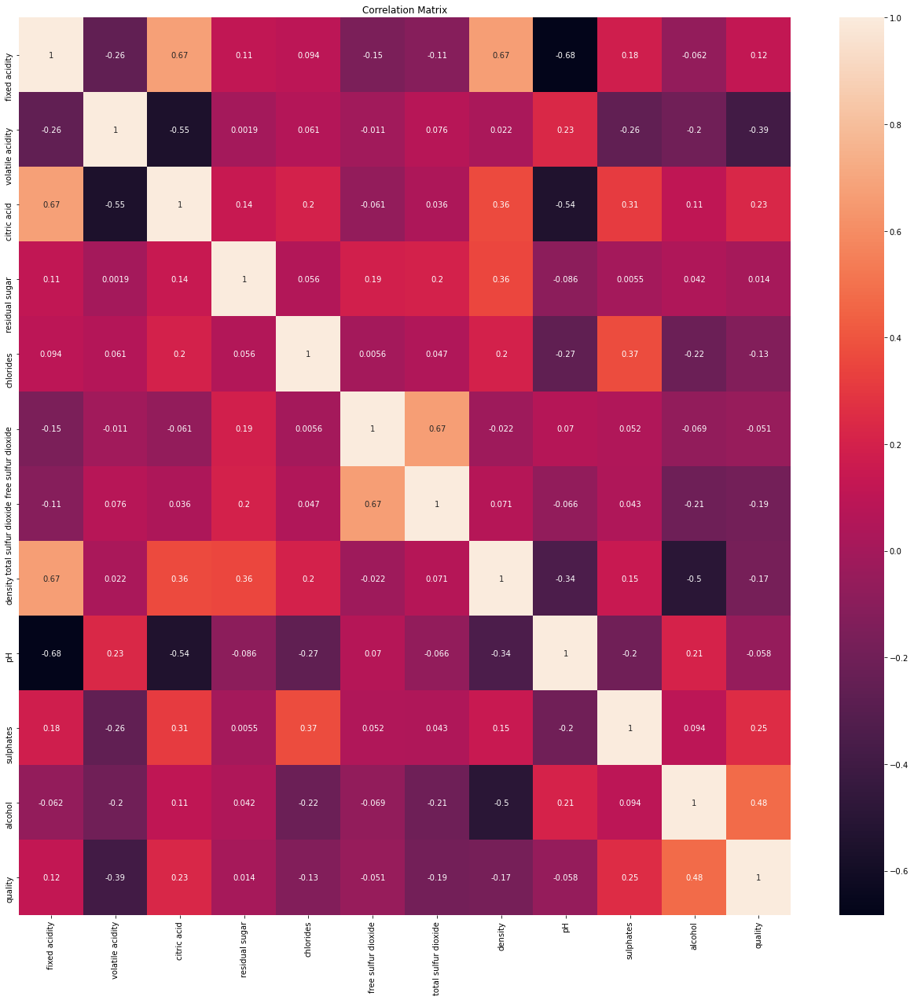

In [17]:
plt.figure(figsize= [22,21])
sns.heatmap(corr_mat,annot=True)
plt.title("Correlation Matrix")
plt.show()

In [18]:
# There is no strong co relation between features

In [19]:
# Logistic Regression Model Building 

import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.metrics import accuracy_score,confusion_matrix,roc_curve,roc_auc_score
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

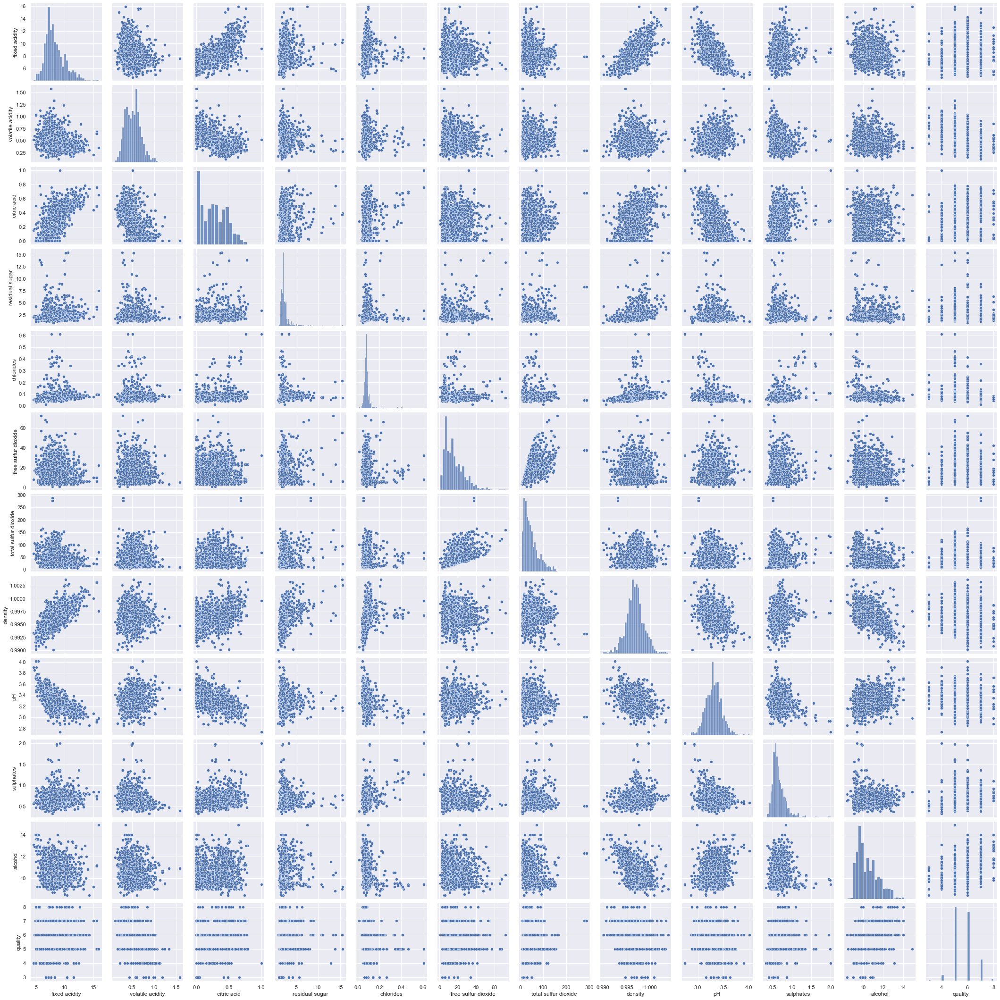

In [20]:
sns.pairplot(data=df)

In [21]:
#In pairplot analysing the relation between features

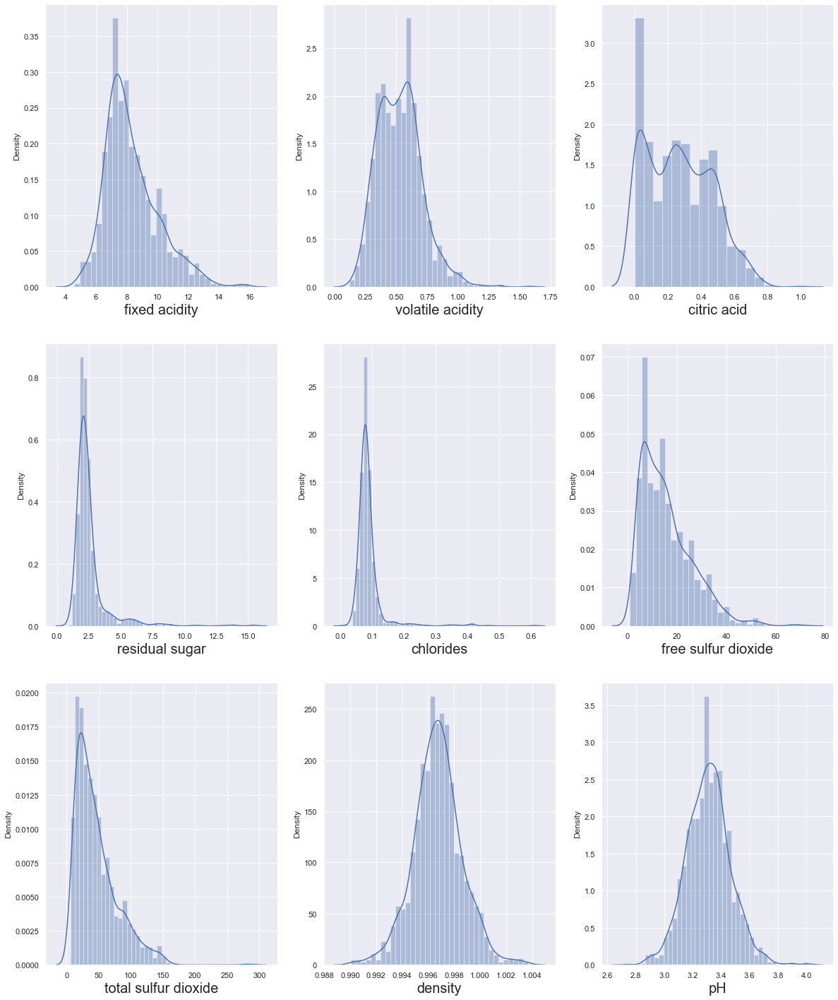

In [22]:
# Analysing feature distribution 

plt.figure(figsize=(20,25),facecolor='white')
plotnumber=1

for column in df:
    if plotnumber<=9:
        ax=plt.subplot(3,3,plotnumber)
        sns.distplot(df[column])
        plt.xlabel(column,fontsize=20)
    plotnumber+=1
plt.show()
        

In [23]:
#After looking distplot,There are right and left skewed featues in dataset

#Right Skewed features -fixed acidity,'volatile acidity','citric acid',residual sugar,chlorides,free sulfur dioxide,
#total sulfur dioxide,



In [25]:
# Checking null value in Dataset

df.isnull().sum()

fixed acidity           0
volatile acidity        0
citric acid             0
residual sugar          0
chlorides               0
free sulfur dioxide     0
total sulfur dioxide    0
density                 0
pH                      0
sulphates               0
alcohol                 0
quality                 0
dtype: int64

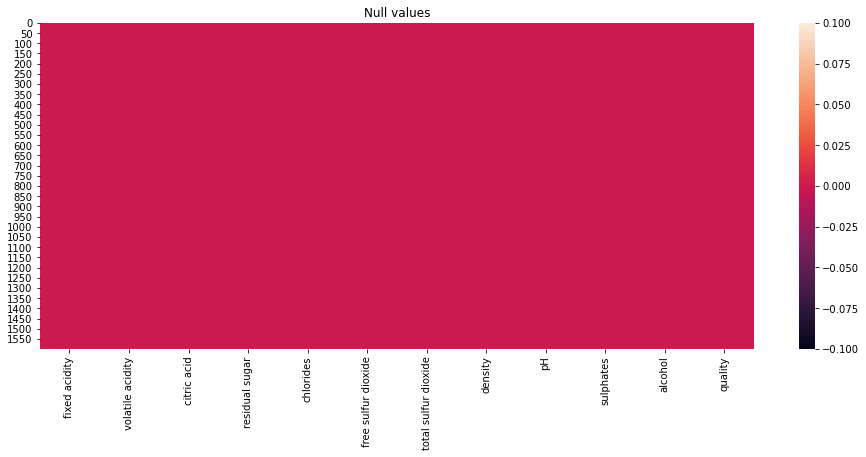

In [26]:
plt.figure(figsize=[16,6])
sns.heatmap(df.isnull())
plt.title("Null values")
plt.show()

In [27]:
# No null value in features

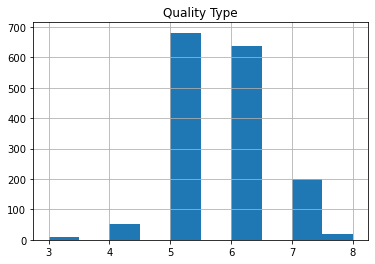

In [28]:
# Label Analysis
df['quality'].hist(grid=True)
plt.title("Quality Type")
plt.show()

In [29]:
#checking skewness
x.skew()

fixed acidity           0.982751
volatile acidity        0.671593
citric acid             0.318337
residual sugar          4.540655
chlorides               5.680347
free sulfur dioxide     1.250567
total sulfur dioxide    1.515531
density                 0.071288
pH                      0.193683
sulphates               2.428672
alcohol                 0.860829
dtype: float64

In [30]:
# Skewness
#Value>0.5 and < -0.5 are skewed 
#fixed acidity,volatile acidity,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,sulphates,alcohol 

In [31]:
#we can see skewness in the dataset. we can remove the skewness using power transforn function

In [32]:
x1=df[['fixed acidity','volatile acidity','residual sugar','chlorides','free sulfur dioxide','total sulfur dioxide','sulphates','alcohol']]
x1.head()
x2=df.drop(columns=['fixed acidity','volatile acidity','residual sugar','chlorides','free sulfur dioxide','total sulfur dioxide','sulphates','alcohol'],axis=1)
x2.head()

,citric acid,density,pH,quality
0,0.00,0.9978,3.51,5
1,0.00,0.9968,3.20,5
2,0.04,0.9970,3.26,5
3,0.56,0.9980,3.16,6
4,0.00,0.9978,3.51,5


In [33]:
from sklearn.preprocessing import power_transform
df_new=power_transform(x1)
df_new=pd.DataFrame(df_new,columns=x1.columns)

In [34]:
df_new.skew()

fixed acidity           0.002529
volatile acidity        0.003099
residual sugar         -0.015715
chlorides              -0.151304
free sulfur dioxide    -0.009948
total sulfur dioxide   -0.003752
sulphates               0.009985
alcohol                 0.112372
dtype: float64

In [35]:
# There is no skewness has been removed of all skewed features in dataset

In [36]:
#Cocating the data again
x = pd.concat([df_new, x2], axis=1)
x.shape

(1599, 12)

In [37]:
x.head()

,fixed acidity,volatile acidity,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,sulphates,alcohol,citric acid,density,pH,quality
0,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.9978,3.51,5
1,-0.161308,1.771299,0.556565,0.786204,0.993852,0.854954,0.395140,-0.500860,0.00,0.9968,3.20,5
2,-0.161308,1.269801,0.152372,0.560696,0.193450,0.540394,0.183772,-0.500860,0.04,0.9970,3.26,5
3,1.522582,-1.550050,-0.597145,-0.226113,0.385115,0.693699,-0.392318,-0.500860,0.56,0.9980,3.16,6
4,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.9978,3.51,5


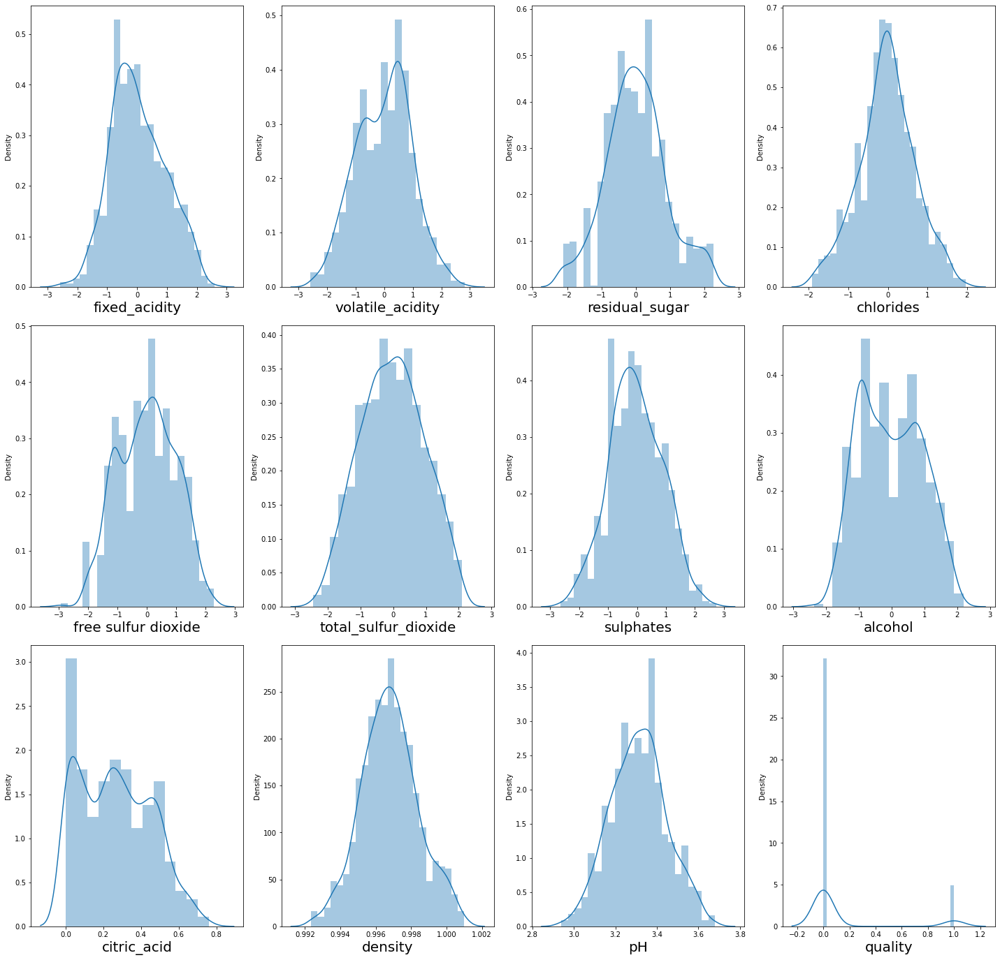

In [135]:
plt.figure(figsize=(20,25),facecolor='white')
plotnumber=1
for column in x:
    if plotnumber<=14:
        ax=plt.subplot(4,4,plotnumber)
        sns.distplot(x[column])
        plt.xlabel(column,fontsize=20)
       
    
    plotnumber+=1
plt.tight_layout() 

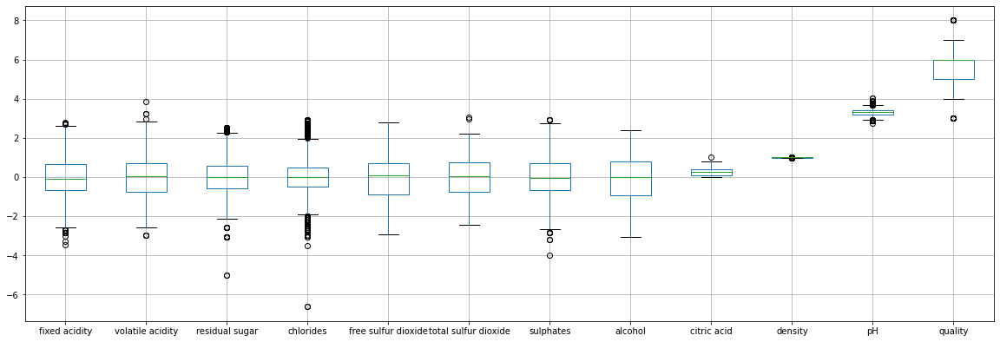

In [39]:
#Plotting Boxplot to understand outlier

x.boxplot(figsize=[20,8],)
plt.subplots_adjust(bottom=.25)
plt.show()

In [40]:
#Outlier treatment

In [41]:
x.columns

Index(['fixed acidity', 'volatile acidity', 'residual sugar', 'chlorides',
       'free sulfur dioxide', 'total sulfur dioxide', 'sulphates', 'alcohol',
       'citric acid', 'density', 'pH', 'quality'],
      dtype='object')

In [42]:
# Rename features in order to apply boxplot outlier treatment
result=x.rename(columns={'fixed acidity':'fixed_acidity','volatile acidity':'volatile_acidity',
                         'citric acid':'citric_acid','residual sugar':'residual_sugar',
                         'total sulfur dioxide':'total_sulfur_dioxide'},inplace=True)

In [43]:
q1=x.quantile(0.25)

#3rd quantile

q3=x.quantile(0.75)

# IQR

iqr=q3-q1

In [44]:
x.head()

,fixed_acidity,volatile_acidity,residual_sugar,chlorides,free sulfur dioxide,total_sulfur_dioxide,sulphates,alcohol,citric_acid,density,pH,quality
0,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.9978,3.51,5
1,-0.161308,1.771299,0.556565,0.786204,0.993852,0.854954,0.395140,-0.500860,0.00,0.9968,3.20,5
2,-0.161308,1.269801,0.152372,0.560696,0.193450,0.540394,0.183772,-0.500860,0.04,0.9970,3.26,5
3,1.522582,-1.550050,-0.597145,-0.226113,0.385115,0.693699,-0.392318,-0.500860,0.56,0.9980,3.16,6
4,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.9978,3.51,5


In [45]:
index=np.where(x['fixed_acidity']>(q3.fixed_acidity +(1.5*iqr.fixed_acidity)))
x=x.drop(x.index[index])
x.reset_index()

,index,fixed_acidity,volatile_acidity,residual_sugar,chlorides,free sulfur dioxide,total_sulfur_dioxide,sulphates,alcohol,citric_acid,density,pH,quality
0,0,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.99780,3.51,5
1,1,-0.161308,1.771299,0.556565,0.786204,0.993852,0.854954,0.395140,-0.500860,0.00,0.99680,3.20,5
2,2,-0.161308,1.269801,0.152372,0.560696,0.193450,0.540394,0.183772,-0.500860,0.04,0.99700,3.26,5
3,3,1.522582,-1.550050,-0.597145,-0.226113,0.385115,0.693699,-0.392318,-0.500860,0.56,0.99800,3.16,6
4,4,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.99780,3.51,5
5,5,-0.442666,0.802929,-0.837193,-0.226113,-0.021924,0.107498,-0.581650,-1.075025,0.00,0.99780,3.51,5
6,6,-0.094677,0.497996,-1.404288,-0.566402,0.193450,0.669200,-1.739501,-1.075025,0.06,0.99640,3.30,5
7,7,-0.516971,0.753478,-3.045490,-0.814706,0.193450,-0.799912,-1.605418,-0.249498,0.00,0.99460,3.39,7
8,8,-0.161308,0.391782,-0.380998,-0.335468,-0.555712,-1.011651,-0.485467,-0.921731,0.02,0.99680,3.36,7
9,9,-0.370000,-0.058175,2.116898,-0.448846,0.385115,1.475168,1.076325,0.292864,0.36,0.99780,3.35,5


In [46]:
index=np.where(x['volatile_acidity']>(q3.volatile_acidity +(1.5*iqr.volatile_acidity)))
x=x.drop(x.index[index])
x.reset_index()

,index,fixed_acidity,volatile_acidity,residual_sugar,chlorides,free sulfur dioxide,total_sulfur_dioxide,sulphates,alcohol,citric_acid,density,pH,quality
0,0,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.99780,3.51,5
1,1,-0.161308,1.771299,0.556565,0.786204,0.993852,0.854954,0.395140,-0.500860,0.00,0.99680,3.20,5
2,2,-0.161308,1.269801,0.152372,0.560696,0.193450,0.540394,0.183772,-0.500860,0.04,0.99700,3.26,5
3,3,1.522582,-1.550050,-0.597145,-0.226113,0.385115,0.693699,-0.392318,-0.500860,0.56,0.99800,3.16,6
4,4,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.99780,3.51,5
5,5,-0.442666,0.802929,-0.837193,-0.226113,-0.021924,0.107498,-0.581650,-1.075025,0.00,0.99780,3.51,5
6,6,-0.094677,0.497996,-1.404288,-0.566402,0.193450,0.669200,-1.739501,-1.075025,0.06,0.99640,3.30,5
7,7,-0.516971,0.753478,-3.045490,-0.814706,0.193450,-0.799912,-1.605418,-0.249498,0.00,0.99460,3.39,7
8,8,-0.161308,0.391782,-0.380998,-0.335468,-0.555712,-1.011651,-0.485467,-0.921731,0.02,0.99680,3.36,7
9,9,-0.370000,-0.058175,2.116898,-0.448846,0.385115,1.475168,1.076325,0.292864,0.36,0.99780,3.35,5


In [47]:
index=np.where(x['citric_acid']>(q3.citric_acid +(1.5*iqr.citric_acid)))
x=x.drop(x.index[index])
x.reset_index()


,index,fixed_acidity,volatile_acidity,residual_sugar,chlorides,free sulfur dioxide,total_sulfur_dioxide,sulphates,alcohol,citric_acid,density,pH,quality
0,0,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.99780,3.51,5
1,1,-0.161308,1.771299,0.556565,0.786204,0.993852,0.854954,0.395140,-0.500860,0.00,0.99680,3.20,5
2,2,-0.161308,1.269801,0.152372,0.560696,0.193450,0.540394,0.183772,-0.500860,0.04,0.99700,3.26,5
3,3,1.522582,-1.550050,-0.597145,-0.226113,0.385115,0.693699,-0.392318,-0.500860,0.56,0.99800,3.16,6
4,4,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.99780,3.51,5
5,5,-0.442666,0.802929,-0.837193,-0.226113,-0.021924,0.107498,-0.581650,-1.075025,0.00,0.99780,3.51,5
6,6,-0.094677,0.497996,-1.404288,-0.566402,0.193450,0.669200,-1.739501,-1.075025,0.06,0.99640,3.30,5
7,7,-0.516971,0.753478,-3.045490,-0.814706,0.193450,-0.799912,-1.605418,-0.249498,0.00,0.99460,3.39,7
8,8,-0.161308,0.391782,-0.380998,-0.335468,-0.555712,-1.011651,-0.485467,-0.921731,0.02,0.99680,3.36,7
9,9,-0.370000,-0.058175,2.116898,-0.448846,0.385115,1.475168,1.076325,0.292864,0.36,0.99780,3.35,5


In [48]:
index=np.where(x['residual_sugar']>(q3.residual_sugar +(1.5*iqr.residual_sugar)))
x=x.drop(x.index[index])
x.reset_index()

,index,fixed_acidity,volatile_acidity,residual_sugar,chlorides,free sulfur dioxide,total_sulfur_dioxide,sulphates,alcohol,citric_acid,density,pH,quality
0,0,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.99780,3.51,5
1,1,-0.161308,1.771299,0.556565,0.786204,0.993852,0.854954,0.395140,-0.500860,0.00,0.99680,3.20,5
2,2,-0.161308,1.269801,0.152372,0.560696,0.193450,0.540394,0.183772,-0.500860,0.04,0.99700,3.26,5
3,3,1.522582,-1.550050,-0.597145,-0.226113,0.385115,0.693699,-0.392318,-0.500860,0.56,0.99800,3.16,6
4,4,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.99780,3.51,5
5,5,-0.442666,0.802929,-0.837193,-0.226113,-0.021924,0.107498,-0.581650,-1.075025,0.00,0.99780,3.51,5
6,6,-0.094677,0.497996,-1.404288,-0.566402,0.193450,0.669200,-1.739501,-1.075025,0.06,0.99640,3.30,5
7,7,-0.516971,0.753478,-3.045490,-0.814706,0.193450,-0.799912,-1.605418,-0.249498,0.00,0.99460,3.39,7
8,8,-0.161308,0.391782,-0.380998,-0.335468,-0.555712,-1.011651,-0.485467,-0.921731,0.02,0.99680,3.36,7
9,9,-0.370000,-0.058175,2.116898,-0.448846,0.385115,1.475168,1.076325,0.292864,0.36,0.99780,3.35,5


In [49]:
index=np.where(x['chlorides']>(q3.chlorides +(1.5*iqr.chlorides)))
x=x.drop(x.index[index])
x.reset_index()

,index,fixed_acidity,volatile_acidity,residual_sugar,chlorides,free sulfur dioxide,total_sulfur_dioxide,sulphates,alcohol,citric_acid,density,pH,quality
0,0,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.99780,3.51,5
1,1,-0.161308,1.771299,0.556565,0.786204,0.993852,0.854954,0.395140,-0.500860,0.00,0.99680,3.20,5
2,2,-0.161308,1.269801,0.152372,0.560696,0.193450,0.540394,0.183772,-0.500860,0.04,0.99700,3.26,5
3,3,1.522582,-1.550050,-0.597145,-0.226113,0.385115,0.693699,-0.392318,-0.500860,0.56,0.99800,3.16,6
4,4,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.99780,3.51,5
5,5,-0.442666,0.802929,-0.837193,-0.226113,-0.021924,0.107498,-0.581650,-1.075025,0.00,0.99780,3.51,5
6,6,-0.094677,0.497996,-1.404288,-0.566402,0.193450,0.669200,-1.739501,-1.075025,0.06,0.99640,3.30,5
7,7,-0.516971,0.753478,-3.045490,-0.814706,0.193450,-0.799912,-1.605418,-0.249498,0.00,0.99460,3.39,7
8,8,-0.161308,0.391782,-0.380998,-0.335468,-0.555712,-1.011651,-0.485467,-0.921731,0.02,0.99680,3.36,7
9,9,-0.370000,-0.058175,2.116898,-0.448846,0.385115,1.475168,1.076325,0.292864,0.36,0.99780,3.35,5


In [50]:
index=np.where(x['total_sulfur_dioxide']>(q3.total_sulfur_dioxide +(1.5*iqr.total_sulfur_dioxide)))
x=x.drop(x.index[index])
x.reset_index()

,index,fixed_acidity,volatile_acidity,residual_sugar,chlorides,free sulfur dioxide,total_sulfur_dioxide,sulphates,alcohol,citric_acid,density,pH,quality
0,0,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.99780,3.51,5
1,1,-0.161308,1.771299,0.556565,0.786204,0.993852,0.854954,0.395140,-0.500860,0.00,0.99680,3.20,5
2,2,-0.161308,1.269801,0.152372,0.560696,0.193450,0.540394,0.183772,-0.500860,0.04,0.99700,3.26,5
3,3,1.522582,-1.550050,-0.597145,-0.226113,0.385115,0.693699,-0.392318,-0.500860,0.56,0.99800,3.16,6
4,4,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.99780,3.51,5
5,5,-0.442666,0.802929,-0.837193,-0.226113,-0.021924,0.107498,-0.581650,-1.075025,0.00,0.99780,3.51,5
6,6,-0.094677,0.497996,-1.404288,-0.566402,0.193450,0.669200,-1.739501,-1.075025,0.06,0.99640,3.30,5
7,7,-0.516971,0.753478,-3.045490,-0.814706,0.193450,-0.799912,-1.605418,-0.249498,0.00,0.99460,3.39,7
8,8,-0.161308,0.391782,-0.380998,-0.335468,-0.555712,-1.011651,-0.485467,-0.921731,0.02,0.99680,3.36,7
9,9,-0.370000,-0.058175,2.116898,-0.448846,0.385115,1.475168,1.076325,0.292864,0.36,0.99780,3.35,5


In [51]:
index=np.where(x['density']>(q3.density +(1.5*iqr.density)))
x=x.drop(x.index[index])
x.reset_index()

,index,fixed_acidity,volatile_acidity,residual_sugar,chlorides,free sulfur dioxide,total_sulfur_dioxide,sulphates,alcohol,citric_acid,density,pH,quality
0,0,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.99780,3.51,5
1,1,-0.161308,1.771299,0.556565,0.786204,0.993852,0.854954,0.395140,-0.500860,0.00,0.99680,3.20,5
2,2,-0.161308,1.269801,0.152372,0.560696,0.193450,0.540394,0.183772,-0.500860,0.04,0.99700,3.26,5
3,3,1.522582,-1.550050,-0.597145,-0.226113,0.385115,0.693699,-0.392318,-0.500860,0.56,0.99800,3.16,6
4,4,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.99780,3.51,5
5,5,-0.442666,0.802929,-0.837193,-0.226113,-0.021924,0.107498,-0.581650,-1.075025,0.00,0.99780,3.51,5
6,6,-0.094677,0.497996,-1.404288,-0.566402,0.193450,0.669200,-1.739501,-1.075025,0.06,0.99640,3.30,5
7,7,-0.516971,0.753478,-3.045490,-0.814706,0.193450,-0.799912,-1.605418,-0.249498,0.00,0.99460,3.39,7
8,8,-0.161308,0.391782,-0.380998,-0.335468,-0.555712,-1.011651,-0.485467,-0.921731,0.02,0.99680,3.36,7
9,9,-0.370000,-0.058175,2.116898,-0.448846,0.385115,1.475168,1.076325,0.292864,0.36,0.99780,3.35,5


In [52]:
index=np.where(x['pH']>(q3.pH +(1.5*iqr.pH)))
x=x.drop(x.index[index])
x.reset_index()

,index,fixed_acidity,volatile_acidity,residual_sugar,chlorides,free sulfur dioxide,total_sulfur_dioxide,sulphates,alcohol,citric_acid,density,pH,quality
0,0,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.99780,3.51,5
1,1,-0.161308,1.771299,0.556565,0.786204,0.993852,0.854954,0.395140,-0.500860,0.00,0.99680,3.20,5
2,2,-0.161308,1.269801,0.152372,0.560696,0.193450,0.540394,0.183772,-0.500860,0.04,0.99700,3.26,5
3,3,1.522582,-1.550050,-0.597145,-0.226113,0.385115,0.693699,-0.392318,-0.500860,0.56,0.99800,3.16,6
4,4,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.99780,3.51,5
5,5,-0.442666,0.802929,-0.837193,-0.226113,-0.021924,0.107498,-0.581650,-1.075025,0.00,0.99780,3.51,5
6,6,-0.094677,0.497996,-1.404288,-0.566402,0.193450,0.669200,-1.739501,-1.075025,0.06,0.99640,3.30,5
7,7,-0.516971,0.753478,-3.045490,-0.814706,0.193450,-0.799912,-1.605418,-0.249498,0.00,0.99460,3.39,7
8,8,-0.161308,0.391782,-0.380998,-0.335468,-0.555712,-1.011651,-0.485467,-0.921731,0.02,0.99680,3.36,7
9,9,-0.370000,-0.058175,2.116898,-0.448846,0.385115,1.475168,1.076325,0.292864,0.36,0.99780,3.35,5


In [53]:
index=np.where(x['sulphates']>(q3.sulphates +(1.5*iqr.sulphates)))
x=x.drop(x.index[index])
x.reset_index()

,index,fixed_acidity,volatile_acidity,residual_sugar,chlorides,free sulfur dioxide,total_sulfur_dioxide,sulphates,alcohol,citric_acid,density,pH,quality
0,0,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.99780,3.51,5
1,1,-0.161308,1.771299,0.556565,0.786204,0.993852,0.854954,0.395140,-0.500860,0.00,0.99680,3.20,5
2,2,-0.161308,1.269801,0.152372,0.560696,0.193450,0.540394,0.183772,-0.500860,0.04,0.99700,3.26,5
3,3,1.522582,-1.550050,-0.597145,-0.226113,0.385115,0.693699,-0.392318,-0.500860,0.56,0.99800,3.16,6
4,4,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.99780,3.51,5
5,5,-0.442666,0.802929,-0.837193,-0.226113,-0.021924,0.107498,-0.581650,-1.075025,0.00,0.99780,3.51,5
6,6,-0.094677,0.497996,-1.404288,-0.566402,0.193450,0.669200,-1.739501,-1.075025,0.06,0.99640,3.30,5
7,7,-0.516971,0.753478,-3.045490,-0.814706,0.193450,-0.799912,-1.605418,-0.249498,0.00,0.99460,3.39,7
8,8,-0.161308,0.391782,-0.380998,-0.335468,-0.555712,-1.011651,-0.485467,-0.921731,0.02,0.99680,3.36,7
9,9,-0.370000,-0.058175,2.116898,-0.448846,0.385115,1.475168,1.076325,0.292864,0.36,0.99780,3.35,5


In [54]:
#Outlier treatment on lower side

In [55]:
index=np.where(x['fixed_acidity']<(q1.fixed_acidity -(1.5*iqr.fixed_acidity)))
x=x.drop(x.index[index])
x.reset_index()


,index,fixed_acidity,volatile_acidity,residual_sugar,chlorides,free sulfur dioxide,total_sulfur_dioxide,sulphates,alcohol,citric_acid,density,pH,quality
0,0,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.99780,3.51,5
1,1,-0.161308,1.771299,0.556565,0.786204,0.993852,0.854954,0.395140,-0.500860,0.00,0.99680,3.20,5
2,2,-0.161308,1.269801,0.152372,0.560696,0.193450,0.540394,0.183772,-0.500860,0.04,0.99700,3.26,5
3,3,1.522582,-1.550050,-0.597145,-0.226113,0.385115,0.693699,-0.392318,-0.500860,0.56,0.99800,3.16,6
4,4,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.99780,3.51,5
5,5,-0.442666,0.802929,-0.837193,-0.226113,-0.021924,0.107498,-0.581650,-1.075025,0.00,0.99780,3.51,5
6,6,-0.094677,0.497996,-1.404288,-0.566402,0.193450,0.669200,-1.739501,-1.075025,0.06,0.99640,3.30,5
7,7,-0.516971,0.753478,-3.045490,-0.814706,0.193450,-0.799912,-1.605418,-0.249498,0.00,0.99460,3.39,7
8,8,-0.161308,0.391782,-0.380998,-0.335468,-0.555712,-1.011651,-0.485467,-0.921731,0.02,0.99680,3.36,7
9,9,-0.370000,-0.058175,2.116898,-0.448846,0.385115,1.475168,1.076325,0.292864,0.36,0.99780,3.35,5


In [56]:
index=np.where(x['volatile_acidity']<(q1.volatile_acidity -(1.5*iqr.volatile_acidity)))
x=x.drop(x.index[index])
x.reset_index()


,index,fixed_acidity,volatile_acidity,residual_sugar,chlorides,free sulfur dioxide,total_sulfur_dioxide,sulphates,alcohol,citric_acid,density,pH,quality
0,0,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.99780,3.51,5
1,1,-0.161308,1.771299,0.556565,0.786204,0.993852,0.854954,0.395140,-0.500860,0.00,0.99680,3.20,5
2,2,-0.161308,1.269801,0.152372,0.560696,0.193450,0.540394,0.183772,-0.500860,0.04,0.99700,3.26,5
3,3,1.522582,-1.550050,-0.597145,-0.226113,0.385115,0.693699,-0.392318,-0.500860,0.56,0.99800,3.16,6
4,4,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.99780,3.51,5
5,5,-0.442666,0.802929,-0.837193,-0.226113,-0.021924,0.107498,-0.581650,-1.075025,0.00,0.99780,3.51,5
6,6,-0.094677,0.497996,-1.404288,-0.566402,0.193450,0.669200,-1.739501,-1.075025,0.06,0.99640,3.30,5
7,7,-0.516971,0.753478,-3.045490,-0.814706,0.193450,-0.799912,-1.605418,-0.249498,0.00,0.99460,3.39,7
8,8,-0.161308,0.391782,-0.380998,-0.335468,-0.555712,-1.011651,-0.485467,-0.921731,0.02,0.99680,3.36,7
9,9,-0.370000,-0.058175,2.116898,-0.448846,0.385115,1.475168,1.076325,0.292864,0.36,0.99780,3.35,5


In [57]:
index=np.where(x['residual_sugar']<(q1.residual_sugar -(1.5*iqr.residual_sugar)))
x=x.drop(x.index[index])
x.reset_index()


,index,fixed_acidity,volatile_acidity,residual_sugar,chlorides,free sulfur dioxide,total_sulfur_dioxide,sulphates,alcohol,citric_acid,density,pH,quality
0,0,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.99780,3.51,5
1,1,-0.161308,1.771299,0.556565,0.786204,0.993852,0.854954,0.395140,-0.500860,0.00,0.99680,3.20,5
2,2,-0.161308,1.269801,0.152372,0.560696,0.193450,0.540394,0.183772,-0.500860,0.04,0.99700,3.26,5
3,3,1.522582,-1.550050,-0.597145,-0.226113,0.385115,0.693699,-0.392318,-0.500860,0.56,0.99800,3.16,6
4,4,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.99780,3.51,5
5,5,-0.442666,0.802929,-0.837193,-0.226113,-0.021924,0.107498,-0.581650,-1.075025,0.00,0.99780,3.51,5
6,6,-0.094677,0.497996,-1.404288,-0.566402,0.193450,0.669200,-1.739501,-1.075025,0.06,0.99640,3.30,5
7,8,-0.161308,0.391782,-0.380998,-0.335468,-0.555712,-1.011651,-0.485467,-0.921731,0.02,0.99680,3.36,7
8,9,-0.370000,-0.058175,2.116898,-0.448846,0.385115,1.475168,1.076325,0.292864,0.36,0.99780,3.35,5
9,10,-1.000662,0.391782,-0.837193,0.750262,0.193450,0.810599,-0.783598,-1.403359,0.08,0.99590,3.28,5


In [58]:
index=np.where(x['chlorides']<(q1.chlorides -(1.5*iqr.chlorides)))
x=x.drop(x.index[index])
x.reset_index()


,index,fixed_acidity,volatile_acidity,residual_sugar,chlorides,free sulfur dioxide,total_sulfur_dioxide,sulphates,alcohol,citric_acid,density,pH,quality
0,0,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.99780,3.51,5
1,1,-0.161308,1.771299,0.556565,0.786204,0.993852,0.854954,0.395140,-0.500860,0.00,0.99680,3.20,5
2,2,-0.161308,1.269801,0.152372,0.560696,0.193450,0.540394,0.183772,-0.500860,0.04,0.99700,3.26,5
3,3,1.522582,-1.550050,-0.597145,-0.226113,0.385115,0.693699,-0.392318,-0.500860,0.56,0.99800,3.16,6
4,4,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.99780,3.51,5
5,5,-0.442666,0.802929,-0.837193,-0.226113,-0.021924,0.107498,-0.581650,-1.075025,0.00,0.99780,3.51,5
6,6,-0.094677,0.497996,-1.404288,-0.566402,0.193450,0.669200,-1.739501,-1.075025,0.06,0.99640,3.30,5
7,8,-0.161308,0.391782,-0.380998,-0.335468,-0.555712,-1.011651,-0.485467,-0.921731,0.02,0.99680,3.36,7
8,9,-0.370000,-0.058175,2.116898,-0.448846,0.385115,1.475168,1.076325,0.292864,0.36,0.99780,3.35,5
9,10,-1.000662,0.391782,-0.837193,0.750262,0.193450,0.810599,-0.783598,-1.403359,0.08,0.99590,3.28,5


In [59]:
index=np.where(x['density']<(q1.density -(1.5*iqr.density)))
x=x.drop(x.index[index])
x.reset_index()


,index,fixed_acidity,volatile_acidity,residual_sugar,chlorides,free sulfur dioxide,total_sulfur_dioxide,sulphates,alcohol,citric_acid,density,pH,quality
0,0,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.99780,3.51,5
1,1,-0.161308,1.771299,0.556565,0.786204,0.993852,0.854954,0.395140,-0.500860,0.00,0.99680,3.20,5
2,2,-0.161308,1.269801,0.152372,0.560696,0.193450,0.540394,0.183772,-0.500860,0.04,0.99700,3.26,5
3,3,1.522582,-1.550050,-0.597145,-0.226113,0.385115,0.693699,-0.392318,-0.500860,0.56,0.99800,3.16,6
4,4,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.99780,3.51,5
5,5,-0.442666,0.802929,-0.837193,-0.226113,-0.021924,0.107498,-0.581650,-1.075025,0.00,0.99780,3.51,5
6,6,-0.094677,0.497996,-1.404288,-0.566402,0.193450,0.669200,-1.739501,-1.075025,0.06,0.99640,3.30,5
7,8,-0.161308,0.391782,-0.380998,-0.335468,-0.555712,-1.011651,-0.485467,-0.921731,0.02,0.99680,3.36,7
8,9,-0.370000,-0.058175,2.116898,-0.448846,0.385115,1.475168,1.076325,0.292864,0.36,0.99780,3.35,5
9,10,-1.000662,0.391782,-0.837193,0.750262,0.193450,0.810599,-0.783598,-1.403359,0.08,0.99590,3.28,5


In [60]:
index=np.where(x['sulphates']<(q1.sulphates -(1.5*iqr.sulphates)))
x=x.drop(x.index[index])
x.reset_index()

,index,fixed_acidity,volatile_acidity,residual_sugar,chlorides,free sulfur dioxide,total_sulfur_dioxide,sulphates,alcohol,citric_acid,density,pH,quality
0,0,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.99780,3.51,5
1,1,-0.161308,1.771299,0.556565,0.786204,0.993852,0.854954,0.395140,-0.500860,0.00,0.99680,3.20,5
2,2,-0.161308,1.269801,0.152372,0.560696,0.193450,0.540394,0.183772,-0.500860,0.04,0.99700,3.26,5
3,3,1.522582,-1.550050,-0.597145,-0.226113,0.385115,0.693699,-0.392318,-0.500860,0.56,0.99800,3.16,6
4,4,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.99780,3.51,5
5,5,-0.442666,0.802929,-0.837193,-0.226113,-0.021924,0.107498,-0.581650,-1.075025,0.00,0.99780,3.51,5
6,6,-0.094677,0.497996,-1.404288,-0.566402,0.193450,0.669200,-1.739501,-1.075025,0.06,0.99640,3.30,5
7,8,-0.161308,0.391782,-0.380998,-0.335468,-0.555712,-1.011651,-0.485467,-0.921731,0.02,0.99680,3.36,7
8,9,-0.370000,-0.058175,2.116898,-0.448846,0.385115,1.475168,1.076325,0.292864,0.36,0.99780,3.35,5
9,10,-1.000662,0.391782,-0.837193,0.750262,0.193450,0.810599,-0.783598,-1.403359,0.08,0.99590,3.28,5


In [61]:
index=np.where(x['pH']<(q1.pH -(1.5*iqr.pH)))
x=x.drop(x.index[index])
x.reset_index()

,index,fixed_acidity,volatile_acidity,residual_sugar,chlorides,free sulfur dioxide,total_sulfur_dioxide,sulphates,alcohol,citric_acid,density,pH,quality
0,0,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.99780,3.51,5
1,1,-0.161308,1.771299,0.556565,0.786204,0.993852,0.854954,0.395140,-0.500860,0.00,0.99680,3.20,5
2,2,-0.161308,1.269801,0.152372,0.560696,0.193450,0.540394,0.183772,-0.500860,0.04,0.99700,3.26,5
3,3,1.522582,-1.550050,-0.597145,-0.226113,0.385115,0.693699,-0.392318,-0.500860,0.56,0.99800,3.16,6
4,4,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.99780,3.51,5
5,5,-0.442666,0.802929,-0.837193,-0.226113,-0.021924,0.107498,-0.581650,-1.075025,0.00,0.99780,3.51,5
6,6,-0.094677,0.497996,-1.404288,-0.566402,0.193450,0.669200,-1.739501,-1.075025,0.06,0.99640,3.30,5
7,8,-0.161308,0.391782,-0.380998,-0.335468,-0.555712,-1.011651,-0.485467,-0.921731,0.02,0.99680,3.36,7
8,9,-0.370000,-0.058175,2.116898,-0.448846,0.385115,1.475168,1.076325,0.292864,0.36,0.99780,3.35,5
9,10,-1.000662,0.391782,-0.837193,0.750262,0.193450,0.810599,-0.783598,-1.403359,0.08,0.99590,3.28,5


In [62]:

x.shape

(1390, 12)

In [63]:
# after removing outlier we droped around approx 7% data

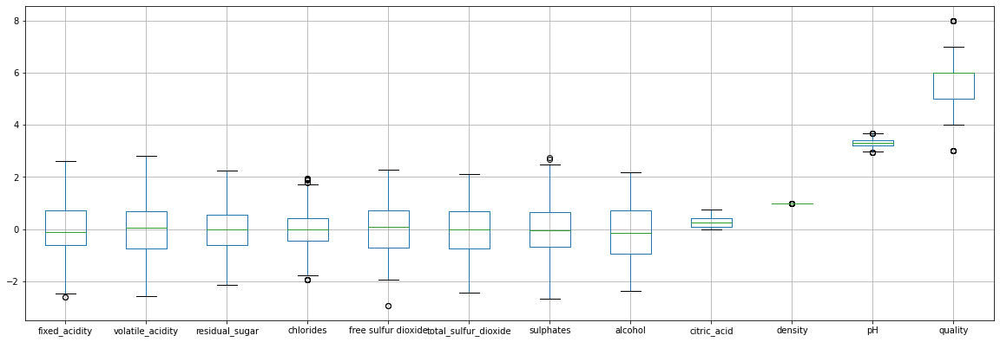

In [64]:
# checking box plot to see outlier 
x.boxplot(figsize=[20,8],)
plt.subplots_adjust(bottom=.25)
plt.show()

In [65]:
# Now data distribution is looking better 

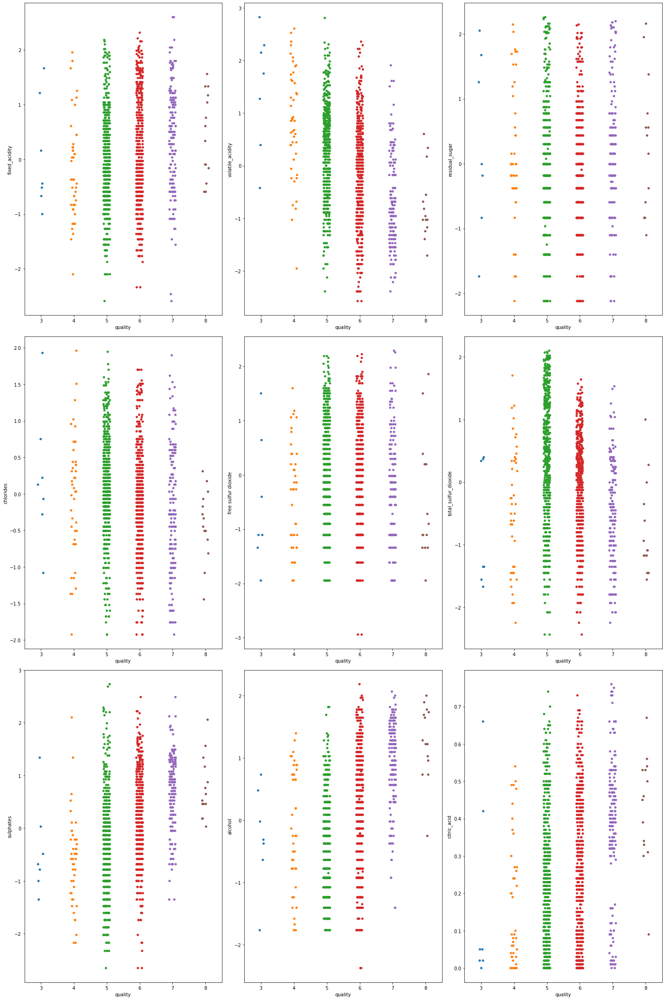

In [66]:
# Analysing relation between each feature and label
plt.figure(figsize=(20,30),facecolor='white')
plotnumber=1

for column in x:
    if plotnumber<=9:
        ax=plt.subplot(3,3,plotnumber)
        sns.stripplot(y,x[column])
    plotnumber+=1
plt.tight_layout()

In [67]:
# Each feature is showing suignificant relation with the label.So,not dropping any feature

In [68]:
df.dtypes

fixed acidity           float64
volatile acidity        float64
citric acid             float64
residual sugar          float64
chlorides               float64
free sulfur dioxide     float64
total sulfur dioxide    float64
density                 float64
pH                      float64
sulphates               float64
alcohol                 float64
quality                   int64
dtype: object

In [69]:
# Coverting in 0 and 1
#0- Bad
#1=Good

x['quality']=x['quality'].replace({3:0,7:1})
x['quality']=x['quality'].replace({4:0,8:1})
x['quality']=x['quality'].replace({5:0,8:1})
x['quality']=x['quality'].replace({6:0,8:1})

In [70]:
x['quality'].value_counts()

0    1206
1     184
Name: quality, dtype: int64

In [71]:
x.head()

,fixed_acidity,volatile_acidity,residual_sugar,chlorides,free sulfur dioxide,total_sulfur_dioxide,sulphates,alcohol,citric_acid,density,pH,quality
0,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.9978,3.51,0
1,-0.161308,1.771299,0.556565,0.786204,0.993852,0.854954,0.395140,-0.500860,0.00,0.9968,3.20,0
2,-0.161308,1.269801,0.152372,0.560696,0.193450,0.540394,0.183772,-0.500860,0.04,0.9970,3.26,0
3,1.522582,-1.550050,-0.597145,-0.226113,0.385115,0.693699,-0.392318,-0.500860,0.56,0.9980,3.16,0
4,-0.442666,0.995542,-0.597145,-0.172896,-0.268045,-0.124411,-0.581650,-1.075025,0.00,0.9978,3.51,0


In [72]:
x.shape

(1390, 12)

In [73]:
x.columns

Index(['fixed_acidity', 'volatile_acidity', 'residual_sugar', 'chlorides',
       'free sulfur dioxide', 'total_sulfur_dioxide', 'sulphates', 'alcohol',
       'citric_acid', 'density', 'pH', 'quality'],
      dtype='object')

In [74]:
#Splitting data into features and label
x_1=x.drop(columns=['quality'])
y_1=x['quality']

In [75]:
from imblearn.over_sampling import SMOTE


In [76]:
#Example of Upsampling
from imblearn.over_sampling import SMOTE
SM=SMOTE()
x_over,y_over =SM.fit_resample(x_1,y_1)

In [77]:
y_over.value_counts()

1    1206
0    1206
Name: quality, dtype: int64

In [78]:
# Importind Decesion tree classifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression

In [79]:

maxAccu=0
maxRS=0
for i in range(1,200):
    x_train,x_test,y_train,y_test =train_test_split(x_over,y_over,test_size=.30,random_state=i)
    DT=DecisionTreeClassifier()
    DT.fit(x_train,y_train)
    predrf=DT.predict(x_test)
    acc=accuracy_score(y_test,predrf)
    if acc>maxAccu:
        maxAccu=acc
        maxRS=i
print("Best accuracy is",maxAccu,"on Random_state",maxRS)

Best accuracy is 0.9281767955801105 on Random_state 74


In [80]:
#we have found best random state value as 19.We will create train test split using this random state (19)

In [81]:
 #Creating Train test split

In [82]:
 x_train,x_test,y_train,y_test =train_test_split(x_over,y_over,test_size=.30,random_state=maxRS)

In [83]:
from sklearn.linear_model import LogisticRegression
LR=LogisticRegression()
LR.fit(x_train,y_train)
predlr=LR.predict(x_test)
print(accuracy_score(y_test,predlr))
print(confusion_matrix(y_test,predlr))
print(classification_report(y_test,predlr))

0.8287292817679558
[[278  71]
 [ 53 322]]
              precision    recall  f1-score   support

           0       0.84      0.80      0.82       349
           1       0.82      0.86      0.84       375

    accuracy                           0.83       724
   macro avg       0.83      0.83      0.83       724
weighted avg       0.83      0.83      0.83       724



In [84]:
from sklearn.tree import DecisionTreeClassifier
dt=DecisionTreeClassifier()
dt.fit(x_train,y_train)
preddt=dt.predict(x_test)
print(accuracy_score(y_test,preddt))
print(confusion_matrix(y_test,preddt))
print(classification_report(y_test,preddt))

0.9226519337016574
[[315  34]
 [ 22 353]]
              precision    recall  f1-score   support

           0       0.93      0.90      0.92       349
           1       0.91      0.94      0.93       375

    accuracy                           0.92       724
   macro avg       0.92      0.92      0.92       724
weighted avg       0.92      0.92      0.92       724



In [85]:
from sklearn.ensemble import RandomForestClassifier
rf=RandomForestClassifier()
rf.fit(x_train,y_train)
predrf=rf.predict(x_test)
print(accuracy_score(y_test,predrf))
print(confusion_matrix(y_test,predrf))
print(classification_report(y_test,predrf))

0.962707182320442
[[335  14]
 [ 13 362]]
              precision    recall  f1-score   support

           0       0.96      0.96      0.96       349
           1       0.96      0.97      0.96       375

    accuracy                           0.96       724
   macro avg       0.96      0.96      0.96       724
weighted avg       0.96      0.96      0.96       724



In [86]:
from sklearn.svm import SVC
svm=SVC()
svm.fit(x_train,y_train)
pred_svm=svm.predict(x_test)
print(accuracy_score(y_test,pred_svm))
print(confusion_matrix(y_test,pred_svm))
print(classification_report(y_test,pred_svm))

0.8604972375690608
[[285  64]
 [ 37 338]]
              precision    recall  f1-score   support

           0       0.89      0.82      0.85       349
           1       0.84      0.90      0.87       375

    accuracy                           0.86       724
   macro avg       0.86      0.86      0.86       724
weighted avg       0.86      0.86      0.86       724



In [87]:
from  sklearn.neighbors import KNeighborsClassifier
KNN=KNeighborsClassifier()
KNN.fit(x_train,y_train)
pred_KNN=KNN.predict(x_test)
print(accuracy_score(y_test,pred_KNN))
print(confusion_matrix(y_test,pred_KNN))
print(classification_report(y_test,pred_KNN))

0.8908839779005525
[[274  75]
 [  4 371]]
              precision    recall  f1-score   support

           0       0.99      0.79      0.87       349
           1       0.83      0.99      0.90       375

    accuracy                           0.89       724
   macro avg       0.91      0.89      0.89       724
weighted avg       0.91      0.89      0.89       724



In [88]:
# Hyper Parameter tuning for increasing Model Accuracy

In [89]:
# Hyper Parameter Decesion Tree Model

In [90]:
grid_param={'criterion':['gini','entropy'],
           'max_depth':range(2,30,3),
           'min_samples_leaf':range(1,20,2),
           'min_samples_split':range(2,20,2)}

In [91]:
grid_search=GridSearchCV(estimator=dt,
                        param_grid=grid_param,
                        cv=5,
                        n_jobs=-1)

In [92]:
grid_search.fit(x_train,y_train)

GridSearchCV(cv=5, estimator=DecisionTreeClassifier(), n_jobs=-1,
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': range(2, 30, 3),
                         'min_samples_leaf': range(1, 20, 2),
                         'min_samples_split': range(2, 20, 2)})

In [93]:
best_parameters=grid_search.best_params_
print(best_parameters)

{'criterion': 'gini', 'max_depth': 14, 'min_samples_leaf': 1, 'min_samples_split': 2}


In [129]:
dt=DecisionTreeClassifier(criterion='gini',max_depth=23,min_samples_leaf=1,min_samples_split=2)
dt.fit(x_train,y_train)
preddt=dt.predict(x_test)
dt.score(x_test,y_test)
print(classification_report(y_test,preddt))


              precision    recall  f1-score   support

           0       0.93      0.90      0.91       349
           1       0.91      0.94      0.92       375

    accuracy                           0.92       724
   macro avg       0.92      0.92      0.92       724
weighted avg       0.92      0.92      0.92       724



In [95]:
#Hypertuning Random Forest

In [130]:
params ={'n_estimators':[13,15],
       'criterion':['entropy','Gini'],
       'max_depth':range(2, 30, 3),
       'min_samples_split':range(1, 20, 2),
       'min_samples_leaf':(2, 20, 2)}

grd = GridSearchCV(rf,param_grid=params)
grd.fit(x_train,y_train)
print('best_params =>', grd.best_params_)

rf=grd.best_estimator_ # reinstantiating with best params
rf.fit(x_train,y_train)
y_pred=rf.predict(x_test)

fr_conf_mat= confusion_matrix(y_test,y_pred)
print('conf_mat =>','\n',fr_conf_mat)

print('Accuracy rf Normal =====>',accuracy_score(y_test,y_pred))
print(classification_report(y_test,predrf))

best_params => {'criterion': 'entropy', 'max_depth': 17, 'min_samples_leaf': 2, 'min_samples_split': 7, 'n_estimators': 15}
conf_mat => 
 [[323  26]
 [ 17 358]]
Accuracy rf Normal =====> 0.9406077348066298
              precision    recall  f1-score   support

           0       0.96      0.96      0.96       349
           1       0.96      0.97      0.96       375

    accuracy                           0.96       724
   macro avg       0.96      0.96      0.96       724
weighted avg       0.96      0.96      0.96       724



In [97]:
#Hyper tuning SVM

In [98]:
param_grid={'C':np.arange(0.001,10,2),
           'gamma':np.arange(0.1,1,.1)}

In [99]:
# lets see the best performace according to gridsearch
gridsearch=GridSearchCV(svm,param_grid)

In [100]:
gridsearch.fit(x_train,y_train)

GridSearchCV(estimator=SVC(),
             param_grid={'C': array([1.000e-03, 2.001e+00, 4.001e+00, 6.001e+00, 8.001e+00]),
                         'gamma': array([0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])})

In [101]:
# lets see the best parameters according to gridsearch
gridsearch.best_params_

{'C': 6.001, 'gamma': 0.9}

In [102]:
# we will use best parameter in svc algorithm and check if accuracy is increasing
svc=SVC(C=6,gamma=0.9)

In [103]:
svc.fit(x_train,y_train)

SVC(C=6, gamma=0.9)

In [132]:
y_pred=svc.predict(x_test)
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       0.99      0.96      0.98       349
           1       0.97      0.99      0.98       375

    accuracy                           0.98       724
   macro avg       0.98      0.98      0.98       724
weighted avg       0.98      0.98      0.98       724



In [105]:
svc.score(x_test,y_test)

0.9765193370165746

In [106]:
#Hyper tuning KNN

In [107]:
param_grid ={'algorithm':['kd_tree','brute'],
            'leaf_size':range(12,25),
            'n_neighbors':range(3,8)}

In [108]:
gridserach=GridSearchCV(KNN,param_grid,verbose=3)

In [109]:
gridserach.fit(x_train,y_train)

Fitting 5 folds for each of 130 candidates, totalling 650 fits
[CV 1/5] END algorithm=kd_tree, leaf_size=12, n_neighbors=3;, score=0.885 total time=   0.0s
[CV 2/5] END algorithm=kd_tree, leaf_size=12, n_neighbors=3;, score=0.873 total time=   0.0s
[CV 3/5] END algorithm=kd_tree, leaf_size=12, n_neighbors=3;, score=0.905 total time=   0.0s
[CV 4/5] END algorithm=kd_tree, leaf_size=12, n_neighbors=3;, score=0.899 total time=   0.0s
[CV 5/5] END algorithm=kd_tree, leaf_size=12, n_neighbors=3;, score=0.875 total time=   0.0s
[CV 1/5] END algorithm=kd_tree, leaf_size=12, n_neighbors=4;, score=0.885 total time=   0.0s
[CV 2/5] END algorithm=kd_tree, leaf_size=12, n_neighbors=4;, score=0.888 total time=   0.0s
[CV 3/5] END algorithm=kd_tree, leaf_size=12, n_neighbors=4;, score=0.920 total time=   0.0s
[CV 4/5] END algorithm=kd_tree, leaf_size=12, n_neighbors=4;, score=0.902 total time=   0.0s
[CV 5/5] END algorithm=kd_tree, leaf_size=12, n_neighbors=4;, score=0.872 total time=   0.0s
[CV 1/5

GridSearchCV(estimator=KNeighborsClassifier(),
             param_grid={'algorithm': ['kd_tree', 'brute'],
                         'leaf_size': range(12, 25),
                         'n_neighbors': range(3, 8)},
             verbose=3)

In [110]:
gridserach.best_params_

{'algorithm': 'kd_tree', 'leaf_size': 12, 'n_neighbors': 4}

In [111]:
KNN=KNeighborsClassifier(algorithm= 'kd_tree', leaf_size= 12, n_neighbors= 4)

In [133]:
KNN.fit(x_train,y_train)
pred_KNN=KNN.predict(x_test)
print(classification_report(y_test,pred_KNN))


              precision    recall  f1-score   support

           0       0.98      0.85      0.91       349
           1       0.87      0.98      0.93       375

    accuracy                           0.92       724
   macro avg       0.93      0.92      0.92       724
weighted avg       0.93      0.92      0.92       724



In [113]:
KNN.score(x_train,y_train)

0.9514218009478673

In [118]:
KNN.score(x_test,y_test)

0.9185082872928176

In [115]:
#AUC and ROC Curve

In [119]:
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import roc_auc_score,roc_curve
from sklearn.metrics import plot_roc_curve

In [120]:

dt=DecisionTreeClassifier()
rf=RandomForestClassifier()
svm=SVC()
kn=KNeighborsClassifier()

In [122]:
# Training with all classifier

svm.fit(x_train,y_train)
dt.fit(x_train,y_train)
rf.fit(x_train,y_train)
kn.fit(x_train,y_train)

print('All models are trained')

All models are trained


In [123]:
# All models scored captured

svm.score(x_train,y_train)
dt.score(x_train,y_train)
rf.score(x_train,y_train)
kn.score(x_train,y_train)

print('All models test score captured ')


All models test score captured 


In [ ]:
#Lest find AUC and ROC score

In [124]:
# Logistic Classifier
roc_auc_score(y_test,svm.predict(x_test))

0.8589761222540593

In [125]:
# Decisiontree Classifier
roc_auc_score(y_test,dt.predict(x_test))

0.9261547277936962

In [126]:
# Randomforest Classifier
roc_auc_score(y_test,rf.predict(x_test))

0.9542120343839541

In [127]:
# KNN Classifier
roc_auc_score(y_test,kn.predict(x_test))

0.8872168099331422

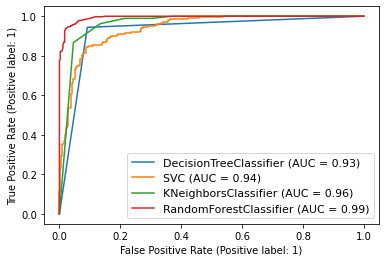

In [128]:
disp=plot_roc_curve(dt,x_test,y_test)
plot_roc_curve(svm,x_test,y_test,ax=disp.ax_) # ax_=Axes with the Confusion matrix
plot_roc_curve(kn,x_test,y_test,ax=disp.ax_)
plot_roc_curve(rf,x_test,y_test,ax=disp.ax_)
plt.legend(prop={'size':11},loc='lower right')
plt.show()

In [ ]:
After analysing AUC ROC curve,Randomforest is best among all.

In [ ]:

      Model Accuracy      Cross Validation Score      Diff
KNN    89                        95                    5
DT     92                        92                    0
RF     96                        96                    0
SVC    86                        98                    12

Since diff is zero for DT,RF.So, DT,RF are the best model 

In [ ]:
#Random forest is best Model

In [ ]:
import pickle

# writing diffrent model files to file

with open('modelForPrediction.sav','rf') as f:
    pickle.dump(rf,f)
    
with open ('SandardScalar.sav','rf') as f:
    pickle.dump(scalar,f)